# End-to-end Multi-Class Dog Breed 🐶 Classification

This notebook builds an end-to-end multi-class image classifier using TensorFlow 2.0 and TensorFlow Hub

## 1. Problem

Identify the breed of a dog given an image of a dog.

## 2. Data

Found under the `data` folder from kaggle.\
Doc: https://www.kaggle.com/c/dog-breed-identification/data

## 3. Evaluation

The evaluation is a file with prediction probabilities for each dog breed of each test image.\
Doc: www.kaggle.com/competitions/dog-breed-identification/overview/evaluation

## 4. Features

* Unstructured data (images) so it's best to use Deep / Transfer Learning.
* 120 dog breeds (classes).
* 10k sample images in the training set - with labels.
* 10k sample images in the test set - without labels.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import tensorflow_hub as hub

%matplotlib inline

In [2]:
print(f"Tensorflow: {tf.__version__}\nTensorflow Hub: {hub.__version__}")
print("GPU", "available" if tf.config.list_physical_devices else "unavailable")

Tensorflow: 2.10.0
Tensorflow Hub: 0.8.0
GPU available


You can also check online GPU speed difference by visiting: https://colab.research.google.com/notebooks/gpu.ipynb \
Make sure you Change runtime and select a GPU.

## Convert data into Tensors

With all ML models, the data have to be in numerical format. We will turn all images into Tensors - numerical representations.

In [3]:
labels_csv = pd.read_csv("data/labels.csv")
labels_csv

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever
...,...,...
10217,ffd25009d635cfd16e793503ac5edef0,borzoi
10218,ffd3f636f7f379c51ba3648a9ff8254f,dandie_dinmont
10219,ffe2ca6c940cddfee68fa3cc6c63213f,airedale
10220,ffe5f6d8e2bff356e9482a80a6e29aac,miniature_pinscher


In [4]:
labels_csv.describe()

,id,breed
count,10222,10222
unique,10222,120
top,000bec180eb18c7604dcecc8fe0dba07,scottish_deerhound
freq,1,126


In [5]:
# Count images by breed
pd.set_option('display.max_rows', None)
labels_csv.breed.value_counts()

breed
scottish_deerhound                126
maltese_dog                       117
afghan_hound                      116
entlebucher                       115
bernese_mountain_dog              114
shih-tzu                          112
great_pyrenees                    111
pomeranian                        111
basenji                           110
samoyed                           109
airedale                          107
tibetan_terrier                   107
leonberg                          106
cairn                             106
beagle                            105
japanese_spaniel                  105
australian_terrier                102
blenheim_spaniel                  102
miniature_pinscher                102
irish_wolfhound                   101
lakeland_terrier                   99
saluki                             99
papillon                           96
norwegian_elkhound                 95
whippet                            95
siberian_husky                     95
pug   

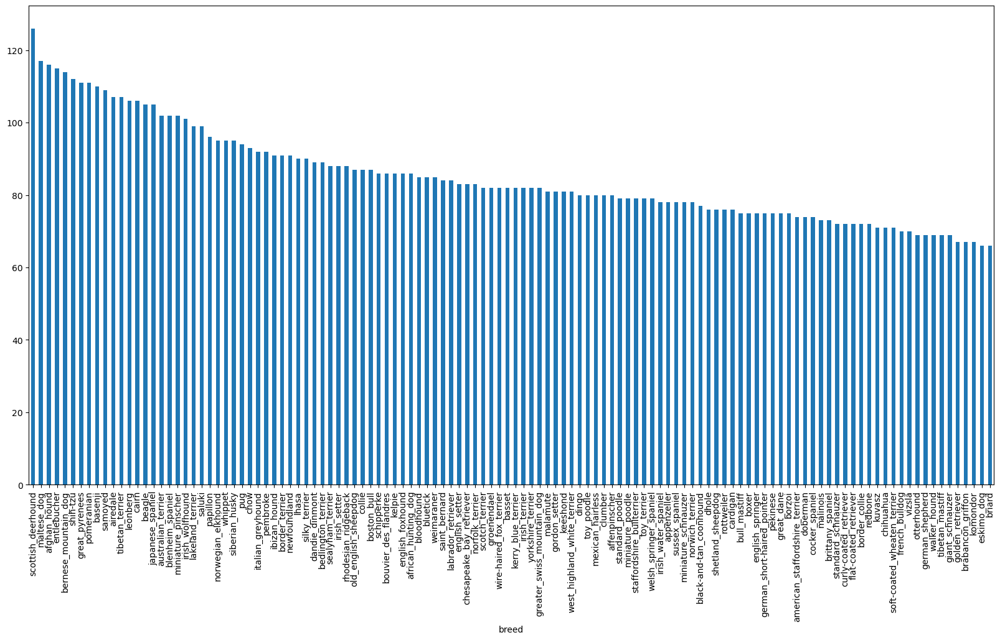

In [6]:
labels_csv.breed.value_counts().plot.bar(figsize=(20,10));

In [7]:
labels_csv.breed.value_counts().median()

82.0

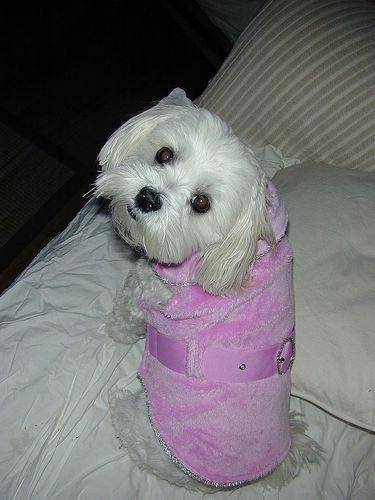

In [8]:
# Image Viewer
from IPython.display import Image
Image("data/train/0d96ca29ff2e557e93c3de0ba017ff61.jpg")

## Images and labels

In [9]:
filenames = ["data/train/" + fname + ".jpg" for fname in labels_csv.id]
filenames[:10]

['data/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'data/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'data/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'data/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'data/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'data/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'data/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'data/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'data/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'data/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [10]:
# Check if the filenames number match the actual number of images
import os
if len(os.listdir("data/train")) == len(filenames):
    print("[+] Images match generated filenames.")
else:
    print("[-] Images do not match generated filenames.")

[+] Images match generated filenames.


In [11]:
labels = labels_csv.breed.to_numpy()
labels, len(labels)

(array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
        'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object),
 10222)

In [12]:
# Find the unique labels
unique_breeds = np.unique(labels)
unique_breeds, len(unique_breeds)

(array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
        'american_staffordshire_terrier', 'appenzeller',
        'australian_terrier', 'basenji', 'basset', 'beagle',
        'bedlington_terrier', 'bernese_mountain_dog',
        'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
        'bluetick', 'border_collie', 'border_terrier', 'borzoi',
        'boston_bull', 'bouvier_des_flandres', 'boxer',
        'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
        'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
        'chow', 'clumber', 'cocker_spaniel', 'collie',
        'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
        'doberman', 'english_foxhound', 'english_setter',
        'english_springer', 'entlebucher', 'eskimo_dog',
        'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
        'german_short-haired_pointer', 'giant_schnauzer',
        'golden_retriever', 'gordon_setter', 'gre

In [13]:
# Turn each label into a boolean array
boolean_labels = [label == unique_breeds for label in labels]
boolean_labels[:10], len(boolean_labels)

([array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False,  True, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False]),
  array([False, False, False, Fa

In [14]:
# Example: Turn boolean array into integers for 1 element
print(labels[0]) # original label
print(np.where(unique_breeds == labels[0])) # index where label occurs
print(boolean_labels[0].argmax()) # index where label occurs in the boolean array
print(boolean_labels[0].astype(int)) # convert boolean to 0s and 1s

boston_bull
(array([19], dtype=int64),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


## Create validation set

The dataset from Kaggle doesn't come with a validation set, so we are creating one.

In [15]:
# Setup X & y variables
X = filenames
y = boolean_labels

Always start off experimenting with ~1000 images (samples) and increase as needed to avoid long run times while experimenting and training.\
This is an advice for any ML training.

In [16]:
# Set a Global variable to use for experimenting
# Change the following NUM_IMAGES = 1000 if you are training and change it to all the samples if you are ready to go
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:1000, step:100} <~ works only on Google collab

In [17]:
from sklearn.model_selection import train_test_split

# Split into training and validation sets of total size NUM_IMAGES
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES], y[:NUM_IMAGES], test_size=0.2, random_state=42)

# Sanity check
len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

## Preprocess Images - Tensors conversion

We will create a function that does the following:
1. Take image `filepath` as an input.
2. Use TensorFlow to read the file and save to a variable `image`.
3. Turn `image` into Tensors.
4. Normalize the `image` by converting color channel values from 0-255 to 0-1.
5. Resize the `image` to a specific shape of (224, 224). This is standard practise - the resizing, not the exact shape.
6. Return the modified `image`.

Doc: https://www.tensorflow.org/tutorials/load_data/images

In [18]:
# Example
# Convert image to numpy array
from matplotlib.pyplot import imread

image = imread(filenames[42]) # Random number
image.shape

(257, 350, 3)

In [19]:
# Creates a tensor constant from the array
tf.constant(image)

<tf.Tensor: shape=(257, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]],

       [[ 56, 104,  66],
        [ 58, 106,  66],
        [ 64, 112,  72],
        ...,
        [ 71, 127,  82],
        [ 73, 129,  84],
        [ 73, 130,  85]],

       ...,

       [[  2,  11,  10],
        [  5,  14,  13],
        [  6,  15,  14],
        ...,
        [120, 113,  67],
        [126, 118,  72],
        [122, 114,  67]],

       [[  0,   4,   6],
        [  0,   9,   8],
        [  1,  10,   9],
        ...,
        [105,  98,  52],
        [111, 104,  58],
        [111, 103,  56]],

       [[ 18,  16,  37],
        [ 18,  18,  28],
        [ 17,  20,  11],
        ...,
        [101,  92,  5

In [20]:
# Define global image size
IMG_SIZE = 224

# Function to convert the image into a tensor
def process_image(image_path, img_size=IMG_SIZE):
    """
    Takes an image file path and turns the image in to a Tensor.
    """
    # Read image
    image = tf.io.read_file(image_path)
    # Turn image in to numerical tensor with 3 color channels (RGB)
    image = tf.image.decode_jpeg(image, channels=3)
    # Normalize values
    image = tf.image.convert_image_dtype(image, tf.float32)
    # Resize image
    image = tf.image.resize(image, size=tf.constant([img_size, img_size], dtype=tf.int32))
    # Return
    return image

## Turn data into batches

**Why turn data into batches?**

To fit in memory.

**Note**

Do not use batche sizes > 32.\
Don't believe me? Search the internet.

In order to use TensorFlow effectively, format the data to tuples like the following:
```
(image, label)
```

In [21]:
# Create function to return tuple of tensors (image, label)
def get_image_label(image_path, label):
    """
    Returns a tuple in the form of (image, label) given an image path name and its label.
    """
    return process_image(image_path), label

In [22]:
# Example
process_image(X[42]), tf.constant(y[42])

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117759],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

In [23]:
# Define global batch size
BATCH_SIZE = 32

# Function to turn data to batches
def create_data_batches(X, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
    """
    Creates batches of data out of image (X) and label (y) pairs.
    Shuffles the data if they are training data but doesn't shuffle if it's validation data.
    May accept test data as input (no labels).
    """
    # If the data is a test dataset it has no labels
    if test_data:
        print("Test data batches...")
        data = tf.data.Dataset.from_tensor_slices((tf.constant(X))) # only filepaths no labels
        data_batch = data.map(process_image).batch(batch_size)
    elif valid_data:
        print("Validation data batches...")
        data = tf.data.Dataset.from_tensor_slices((tf.constant(X), tf.constant(y))) # filepaths and labels
        data_batch = data.map(get_image_label).batch(batch_size)
    else:
        print("Training data batches...")
        data = tf.data.Dataset.from_tensor_slices((tf.constant(X), tf.constant(y)))
        # Shuffle training data before batching
        data = data.shuffle(buffer_size=len(X))
        data_batch = data.map(get_image_label).batch(batch_size)

    return data_batch

In [24]:
# Train and validation data batches
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Training data batches...
Validation data batches...


In [25]:
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Visualizing Data Batches

In [26]:
# Function for viewing images in a data batch
def show_images(images, labels, n=25):
    """
    Displays a plot of N images and their labels from a data batch.
    """
    plt.figure(figsize=(10, 10))
    # Loop
    for i in range(n):
        # Subplots: 5x5
        ax = plt.subplot(5, 5, i+1)
        # Display image
        plt.imshow(images[i])
        # Add label as title
        plt.title(unique_breeds[labels[i].argmax()])
        # Turn gridlines off
        plt.axis("off")

In [27]:
train_images, train_labels = next(train_data.as_numpy_iterator())
len(train_images), len(train_labels)

(32, 32)

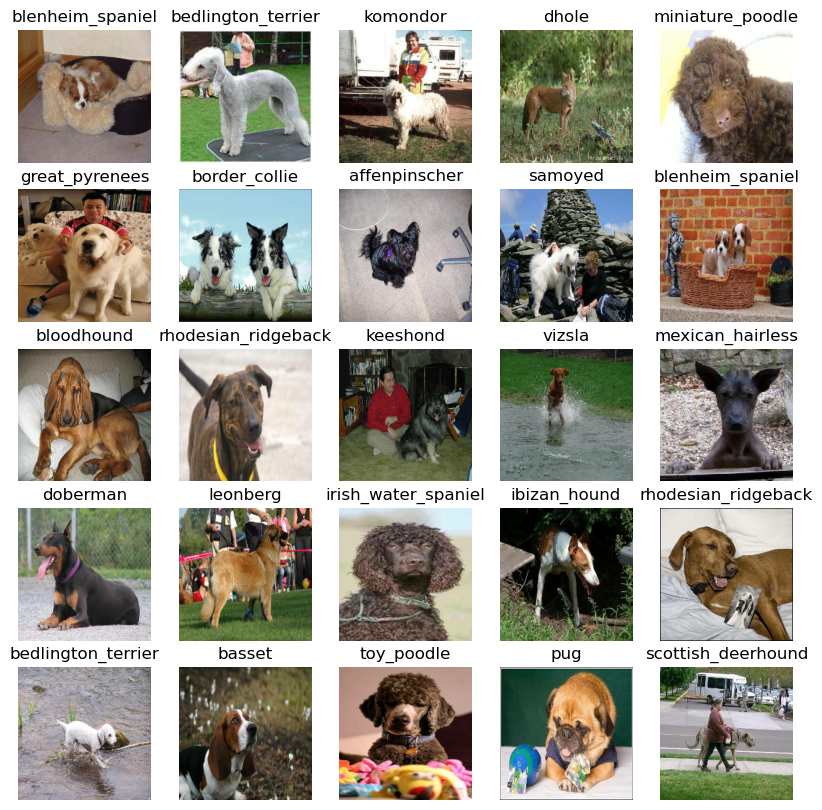

In [28]:
# Visualize training set
show_images(train_images, train_labels)

In [29]:
val_images, val_labels = next(val_data.as_numpy_iterator())
len(val_images), len(val_labels)

(32, 32)

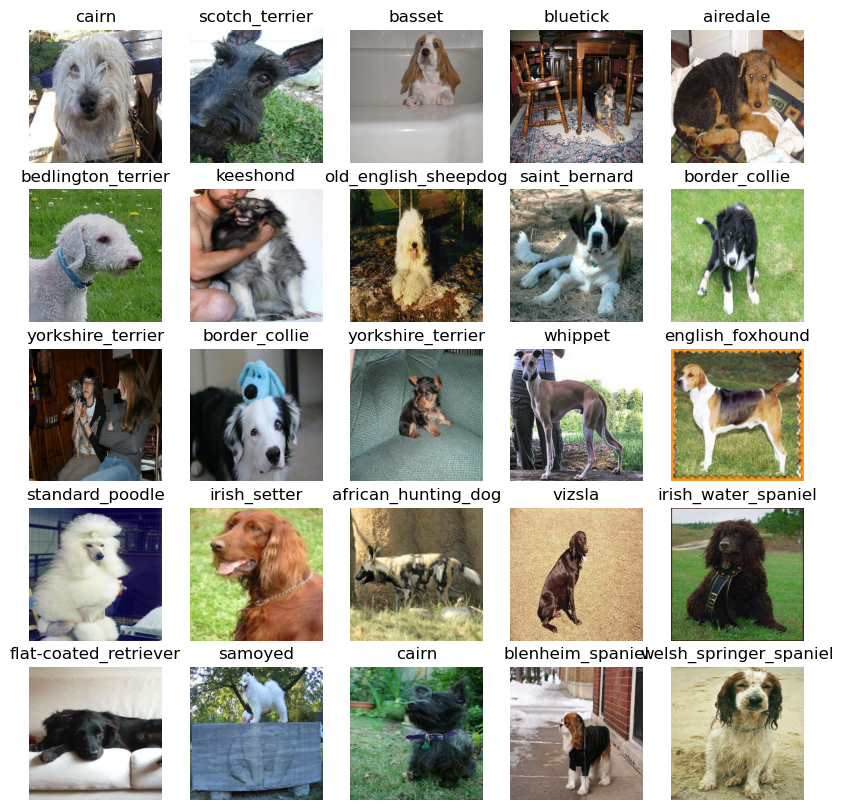

In [30]:
# Visualize validation set
show_images(val_images, val_labels)

## Building a model

Before building a model we need to define:
* Input shape (images shape in the form of tensors).
* Output shape (image labels in the form of tensors).
* The URL of the model to use.

Models: https://www.kaggle.com/models

We could use:
- https://www.kaggle.com/models/google/mobilenet-v2
- https://www.kaggle.com/models/google/resnet-v2

Found by filtering: https://www.kaggle.com/models?task=16686&datatype=14102&framework=tensorFlow2&fine-tunable=true&minUsabilityRating=9.00+or+higher

We will use a variation that supports images sized to 224x224 : https://tfhub.dev/google/imagenet/mobilenet_v2_050_224/classification/5

In [31]:
# Define input shape
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, color channels

# Define output shape
OUTPUT_SHAPE = len(unique_breeds)

# Model URL from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_050_224/classification/5"

After having defined inputs, outputs and models we will use Keras for the Deep-Learning (DL) model.

We will create a function that does the following:
1. Takes the shapes and the defined model.
2. Defines the layers in a Keras model in sequential fashion.
3. Compiles the model (says it should be evaluated and improved).
4. Builds the model (tells the model the input shape).
5. Returns the model.

Doc: https://www.tensorflow.org/guide/keras

In [32]:
# Function for the Keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
    print(f"Building: {MODEL_URL}")
    # Setup model layers
    model = tf.keras.Sequential(
        [
            hub.KerasLayer(MODEL_URL), # Layer 1 (input)
            tf.keras.layers.Dense(units=OUTPUT_SHAPE, activation="softmax"), # Layer 2 (output)
        ]
    )
    # Compile model
    model.compile(
        loss=tf.keras.losses.CategoricalCrossentropy(),
        optimizer=tf.keras.optimizers.Adam(),
        metrics=["accuracy"]
    )
    # Build model
    model.build(INPUT_SHAPE)
    return model

Notes:
* For binary classification use:
    * Activation: Sigmoid
    * Loss: Binary Crossentropy
* For multi-class classification use:
    * Activation: Softmax
    * Loss: Categorical Crossentropy

In [33]:
model = create_model()
model.summary()

Building: https://tfhub.dev/google/imagenet/mobilenet_v2_050_224/classification/5
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              1988505   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 2,108,745
Trainable params: 120,240
Non-trainable params: 1,988,505
_________________________________________________________________


## Creating callbacks

Callbacks are helper function a model can use during training to do such things as save or check progress or stop training early if it stops improving.

Two callbacks will be created, one for TensorBoard which helps tracking the model's progress and another one for early stopping which prevents the model from training for too long.

### TensorBoard callback

To setup a TensorBoard callback, we need to do 3 things:
1. Load the TensorBoard notebook extension.
2. Create a TensorBoard callback, able to save logs to a directory and pass it to the model's `fit()` function.
3. Visualize the model's training logs with the `%tensorboard` magic function.

In [34]:
# Load TensorBoard notebook extension
%reload_ext tensorboard

In [35]:
import datetime

# Function to build a TensorBoard callback
def create_tensorboard_callback():
    # Create log dir for Tensorboard
    logdir = os.path.join(
        "logs",
        datetime.datetime.now().strftime("%y%m%d-%H%M%S")
    )
    return tf.keras.callbacks.TensorBoard(log_dir=logdir)

### Early Stop callback

Callback function to prevent overfitting: stops the training if the model stops improving.

Doc: https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping

In [36]:
# Function to implement early stop
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor="val_accuracy",
    patience=3
)

## Training a model (subset of data)

Train on a specific number of data instead of the whole dataset to make sure everything is working and we do not waste time.

1. Create a model using `create_model()`.
2. Setup a TensorBoard callback using `create_tensorboard_callback`.
3. Call the `fit()` function on our model passing it the training data, validation data, number of epochs to train for and the callback functions.
4. Return the model.

In [37]:
NUM_EPOCHS = 100 #@param {type: "slider", min: 10, max: 100, step: 10}

# Function to train and return a trained model
def train_model(train_data, num_epochs=NUM_EPOCHS):
    """
    Trains a given model and returns the trained version.
    """
    # Create a model
    model = create_model()
    # Create TensorBoard session everytime a model is trained
    tensorboard = create_tensorboard_callback()
    # Fit the model to the data passing it the created callbacks
    model.fit(
        x=train_data,
        epochs=num_epochs,
        validation_data=val_data,
        validation_freq=1,
        callbacks=[tensorboard, early_stopping]
    )
    return model

In [38]:
model = train_model(train_data)

Building: https://tfhub.dev/google/imagenet/mobilenet_v2_050_224/classification/5
Epoch 1/100
25/25 [==============================] - 11s 190ms/step - loss: 4.7509 - accuracy: 0.0812 - val_loss: 3.5605 - val_accuracy: 0.2050
Epoch 2/100
25/25 [==============================] - 4s 164ms/step - loss: 1.6719 - accuracy: 0.6313 - val_loss: 2.4955 - val_accuracy: 0.3650
Epoch 3/100
25/25 [==============================] - 4s 164ms/step - loss: 0.6148 - accuracy: 0.9225 - val_loss: 2.1686 - val_accuracy: 0.4000
Epoch 4/100
25/25 [==============================] - 4s 167ms/step - loss: 0.2807 - accuracy: 0.9975 - val_loss: 2.0720 - val_accuracy: 0.4250
Epoch 5/100
25/25 [==============================] - 4s 161ms/step - loss: 0.1616 - accuracy: 0.9987 - val_loss: 2.0804 - val_accuracy: 0.4150
Epoch 6/100
25/25 [==============================] - 4s 156ms/step - loss: 0.1107 - accuracy: 1.0000 - val_loss: 2.0504 - val_accuracy: 0.4400
Epoch 7/100
25/25 [==============================] - 4s 157

> The model is overfitting because it's performing far better on the training dataset than the validation dataset.\
> The `val_accuracy` is far lower than `accuracy`.\
> Some ways to prevent model overfitting in Deep Learning Neural Networks.

## Check the TensorBoard logs

The TensorBoard magic function (`%tensorboard`) will access the logs directory and visualize its contents.

In [39]:
%tensorboard --logdir logs/ --host localhost

Reusing TensorBoard on port 6006 (pid 19548), started 12:07:50 ago. (Use '!kill 19548' to kill it.)

## Making and evaluating prediction using a trained model

In [40]:
# Make predictions on validation data - unseen data
predictions = model.predict(val_data, verbose=2)
predictions

7/7 - 1s - 1s/epoch - 170ms/step


array([[9.2159818e-05, 2.3542251e-04, 1.2292336e-05, ..., 9.4759262e-06,
        6.2318181e-04, 3.4172906e-04],
       [1.5115784e-04, 7.5006496e-06, 1.7059488e-02, ..., 2.3299383e-05,
        2.2889317e-03, 2.5167688e-05],
       [8.9813597e-07, 3.0299663e-04, 4.2187280e-06, ..., 3.6071794e-04,
        2.8863653e-06, 5.0399796e-04],
       ...,
       [5.8359697e-06, 2.8397566e-05, 2.9910112e-05, ..., 2.6156098e-05,
        2.1345095e-05, 1.8958322e-05],
       [3.0766174e-04, 2.2485692e-04, 3.4685152e-06, ..., 1.0344592e-05,
        3.0252801e-05, 3.5927391e-03],
       [2.9929630e-05, 1.5050145e-04, 1.1644839e-04, ..., 3.0071512e-03,
        1.6743065e-03, 2.7049638e-05]], dtype=float32)

In [41]:
predictions.shape, len(y_val)

((200, 120), 200)

In [42]:
predictions[0] # The probabilities for each of the 120 breeds for the first image in the validation data

array([9.2159818e-05, 2.3542251e-04, 1.2292336e-05, 2.8094295e-05,
       9.0959817e-05, 1.1345764e-05, 1.1975735e-03, 4.2095512e-06,
       1.5607703e-04, 6.0151369e-06, 3.7376788e-03, 1.9584400e-05,
       6.7427977e-06, 6.3340608e-06, 1.8123236e-03, 3.4826621e-06,
       9.7331997e-07, 6.4653705e-04, 7.8386474e-05, 3.6142640e-06,
       5.2958829e-05, 4.2411204e-05, 1.6354767e-05, 6.3398387e-03,
       3.2630956e-06, 3.1638214e-05, 8.4330045e-02, 3.3000174e-06,
       1.0494758e-05, 2.0729307e-05, 1.6563577e-05, 3.6216047e-04,
       1.2137506e-03, 8.5260763e-06, 1.0699971e-05, 4.7536683e-03,
       3.4873932e-07, 1.0916516e-05, 5.8383244e-05, 4.1155558e-06,
       2.4412810e-04, 5.7595304e-07, 3.2125015e-05, 5.8485784e-05,
       9.7297474e-05, 2.1835936e-05, 2.0534562e-06, 1.8477203e-06,
       8.7319597e-05, 3.6262927e-06, 6.1998899e-06, 7.6450151e-06,
       2.8545957e-04, 2.0079751e-05, 4.7198289e-05, 2.3164015e-05,
       1.3120073e-05, 2.7186151e-03, 2.3574696e-04, 2.8879405e

In [43]:
np.sum(predictions[0]) # All the predictions for each image are summed up (or almost) 1.0

0.99999994

In [44]:
# Let's see the first prediction
idx = 0
print(f"Total sum of predictions: {np.sum(predictions[idx])}")
print(f"Max value (probability of prediction): {np.max(predictions[idx])}")
print(f"Max index: {np.argmax(predictions[idx])}")
print(f"Predicted label: {unique_breeds[np.argmax(predictions[idx])]}")

Total sum of predictions: 0.9999999403953552
Max value (probability of prediction): 0.29957062005996704
Max index: 82
Predicted label: old_english_sheepdog


In [45]:
# Turn prediction probabilities into their respective label
def get_prediction_label(predictions, breeds=unique_breeds):
    """
    Turns an array of prediction probabilities into a label.
    """
    return breeds[np.argmax(predictions)], np.max(predictions)

# Get a predicted label based on an array of prediction probabilities
prediction_label, prediction_confidence = get_prediction_label(predictions[20])
prediction_label, prediction_confidence

('bernese_mountain_dog', 0.39565507)

Since our validation data is still in a batch dataset, we have to unbatchify it to make predictions on the validation images and then compare those predictions to the validation labels (truth labels).

Doc: https://www.tensorflow.org/api_docs/python/tf/data/Dataset#unbatch

In [46]:
# Let's do it for only one of the elements
images_ = []
labels_ = []

# Loop through the unbatched data
for image, label in val_data.unbatch().as_numpy_iterator():
    images_.append(image)
    labels_.append(label)

images_[0], labels_[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [47]:
# Compare the prediction to the actual label
get_prediction_label(predictions[0]), get_prediction_label(labels_[0])

(('old_english_sheepdog', 0.29957062), ('cairn', True))

In [48]:
# Function to unbatchify the batched datasets
def unbatchify(data, breeds=unique_breeds):
    """
    Takes a batched dataset of (image, label) Tensors and returns separate arrays of images and labels.
    """
    images = []
    labels = []
    # Loop
    for image, label in data.unbatch().as_numpy_iterator():
        images.append(image)
        labels.append(label)
    return images, labels

# Could be written better
def get_label_from_array(labels, n, breeds=unique_breeds):
    return breeds[np.argmax(labels[n])]

In [49]:
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0], get_prediction_label(val_labels[0])

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

Now we got:
- Prediction labels
- Validation labels
- Validation images

We will also create a function which:
- Takes an array of prediction probabilities, an array of truth labels and an array of images and integers.
- Converts the prediction probabilities.
- Plots the predicted label, the predicted probability, the truth label and the target image in a single plot.

In [50]:
# Function to plot a single prediction based on index position `n`
def plot_pred(prediction_probabilities, labels, images, n=1, breeds=unique_breeds):
    """
    View the prediction, ground truth and image for sample n.
    """
    preds_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]
    # Get the truth label
    truth_label = get_label_from_array(labels, n)
    # Get the prediction label
    pred_label, _ = get_prediction_label(preds_prob)
    # Plot image
    plt.imshow(image)
    plt.xticks([])
    plt.yticks([])
    # Add some colors if prediction is right or wrong
    color = ("green" if truth_label == pred_label else "red")
    
    # Change plot title to be predicted, probability and truth label
    plt.title("Prediction: {} {:2.0f}%, Truth: {}".format(pred_label, (np.max(preds_prob) * 100), truth_label), color=color)

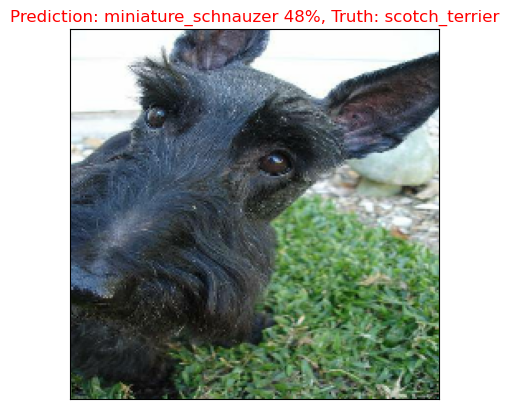

In [51]:
plot_pred(prediction_probabilities=predictions, labels=val_labels, images=val_images, n=1)

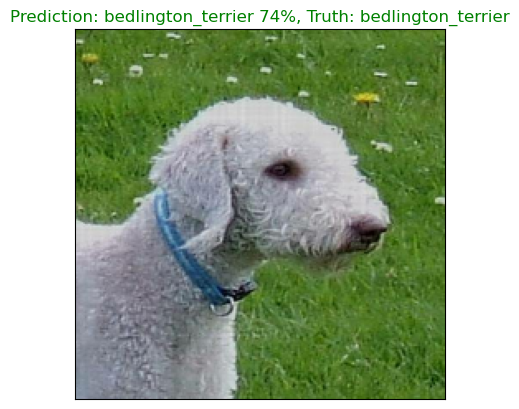

In [52]:
plot_pred(prediction_probabilities=predictions, labels=val_labels, images=val_images, n=5)

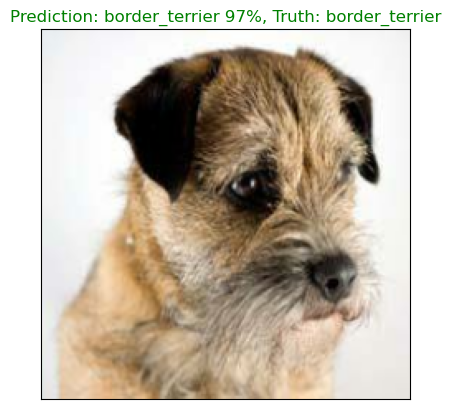

In [53]:
plot_pred(prediction_probabilities=predictions, labels=val_labels, images=val_images, n=56)

Now we can also create a function for top predictions.\
The function will:
- Take an input of prediction probabilities array, a ground truth array and an integer
- Find the prediction using `get_prediction_label()`.
- Find the top N:
    - Prediction probabilities indexes
    - Prediction probabilities values
    - Prediction labels
- Plot the top N prediction probability values and labels - with colors

In [102]:
# Function to plot top predictions
def plot_pred_conf(prediction_probabilities, labels, n=1, topN=10, breeds=unique_breeds):
    """
    Plot the top N prediction confidences along with the truth label for sample n.
    """
    pred_prob, true_label = prediction_probabilities[n], get_label_from_array(labels, n)
    # Get predicted label
    pred_label, _ = get_prediction_label(pred_prob)
    # Find topN prediction confidence indexes
    top_pred_indexes = pred_prob.argsort()[-topN:][::-1]
    # Find topN prediction confidence values
    top_pred_values = pred_prob[top_pred_indexes]
    # Find topN prediction labels
    top_pred_labels = breeds[top_pred_indexes]
    # Plot
    top_plot = plt.bar(
        np.arange(len(top_pred_labels)),
        top_pred_values,
        color="grey"
    )
    plt.xticks(
        np.arange(len(top_pred_labels)),
        labels=top_pred_labels,
        rotation="vertical"
    )
    # Change color of true label
    if np.isin(true_label, top_pred_labels):
        top_plot[np.argmax(top_pred_labels == true_label)].set_color("green")

In [103]:
# Top 10 prediction indexes of index 0
predictions[0].argsort()[-10:][::-1], predictions[0][predictions[0].argsort()[-10:][::-1]]

(array([ 82,  65,  70,  26, 100, 116, 103,  76,  77,  68], dtype=int64),
 array([0.29957062, 0.2419299 , 0.22372127, 0.08433004, 0.02891666,
        0.01430594, 0.01215737, 0.01137258, 0.01073048, 0.0102666 ],
       dtype=float32))

In [104]:
unique_breeds[predictions[0].argsort()[-10:][::-1]]

array(['old_english_sheepdog', 'komondor', 'lhasa', 'cairn', 'shih-tzu',
       'west_highland_white_terrier', 'soft-coated_wheaten_terrier',
       'miniature_poodle', 'miniature_schnauzer', 'lakeland_terrier'],
      dtype=object)

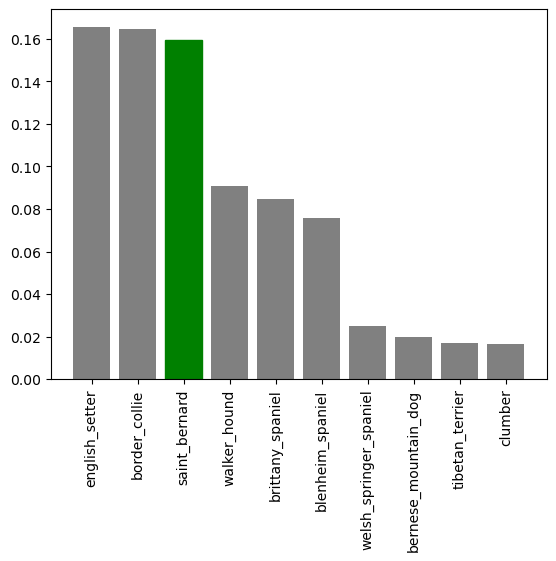

In [105]:
# Plot for index 8
plot_pred_conf(prediction_probabilities=predictions, labels=val_labels, n=8, topN=10)

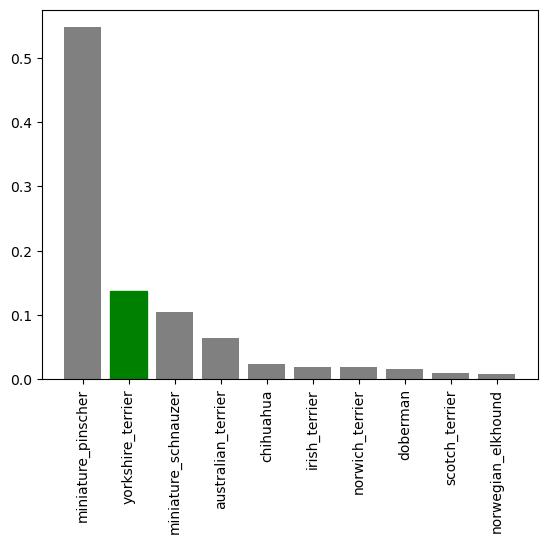

In [106]:
# Plot for index 12
plot_pred_conf(prediction_probabilities=predictions, labels=val_labels, n=12, topN=10)

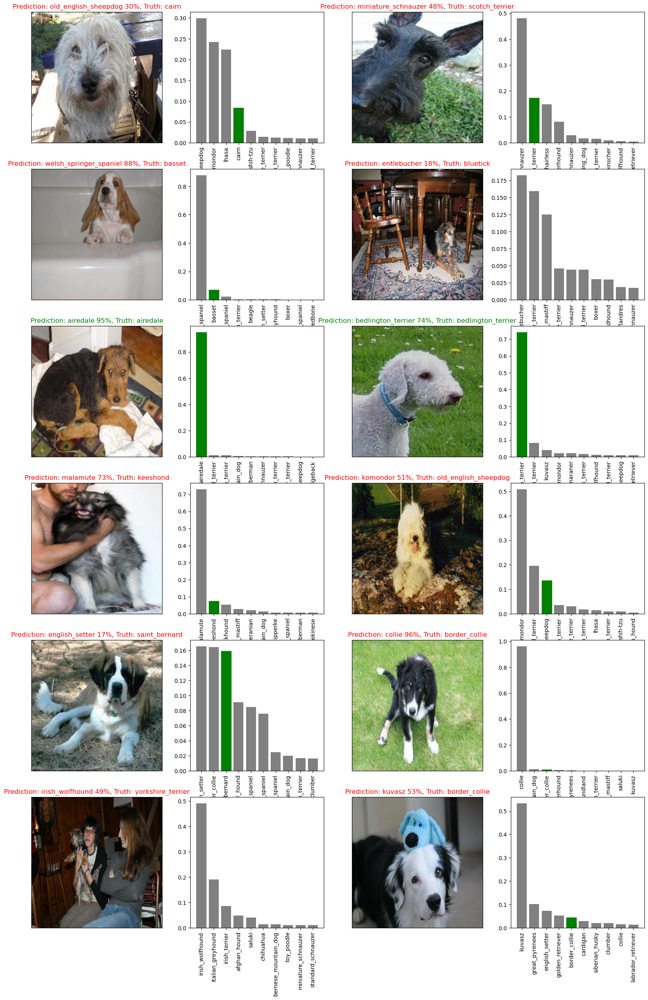

In [107]:
# Check some predictions
i_multiplier = 0
num_rows = 6
num_cols = 2
num_images = num_rows * num_cols
plt.figure(figsize=(10*num_cols, 5*num_rows))
for i in range(num_images):
    plt.subplot(num_rows, 2*num_cols, 2*i+1)
    plot_pred(prediction_probabilities=predictions, labels=val_labels, images=val_images, n=i+i_multiplier)
    plt.subplot(num_rows, 2*num_cols, 2*i+2)
    plot_pred_conf(prediction_probabilities=predictions, labels=val_labels, n=i+i_multiplier)
plt.show()

## Saving and reloading the model

In [60]:
# Function to save a model
def save_model(model, suffix=None):
    """
    Saves a given model in models/ directory and appends a suffix.
    """
    modeldir = os.path.join(
        "models",
        datetime.datetime.now().strftime("%y%m%d-%H%M%S")
    )
    model_path = modeldir + "-" + suffix + ".h5"
    print(f"Saving model to: {model_path}")
    model.save(model_path)
    return model_path

In [61]:
# Function to load a model
def load_model(model_name):
    """
    Loads a given trained model from models/ directory.
    """
    print(f"Loading model: {model_path}")
    model = tf.keras.models.load_model(model_name, custom_objects={"KerasLayer": hub.KerasLayer})
    return model

In [62]:
model_path = save_model(model, suffix="mobilenetv2-Adam")

Saving model to: models\240713-024732-mobilenetv2-Adam.h5


In [63]:
image_model = load_model(model_path)

Loading model: models\240713-024732-mobilenetv2-Adam.h5


In [64]:
# Evaluate initial model
model.evaluate(val_data)

7/7 [==============================] - 1s 107ms/step - loss: 2.0529 - accuracy: 0.4450


[2.0529167652130127, 0.4449999928474426]

In [65]:
# Evaluate saved model
image_model.evaluate(val_data)

7/7 [==============================] - 1s 109ms/step - loss: 2.0529 - accuracy: 0.4450


[2.0529167652130127, 0.4449999928474426]

## Full model

In [66]:
full_model = create_model()

Building: https://tfhub.dev/google/imagenet/mobilenet_v2_050_224/classification/5


In [67]:
# Data batches
full_data = create_data_batches(X, y)
full_data

Training data batches...


<BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [68]:
# Full model callbacks
full_model_tensorboard = create_tensorboard_callback()
# No validation set when training on all the data, so we cannot monitor validation accuracy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy", patience=3)

In [69]:
%%time
# Fit the full model to the data
full_model.fit(x=full_data, epochs=NUM_EPOCHS, callbacks=[full_model_tensorboard, full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 49s 134ms/step - loss: 1.8619 - accuracy: 0.5254
Epoch 2/100
320/320 [==============================] - 43s 135ms/step - loss: 0.8085 - accuracy: 0.7582
Epoch 3/100
320/320 [==============================] - 43s 136ms/step - loss: 0.5620 - accuracy: 0.8267
Epoch 4/100
320/320 [==============================] - 44s 138ms/step - loss: 0.4097 - accuracy: 0.8744
Epoch 5/100
320/320 [==============================] - 43s 134ms/step - loss: 0.3071 - accuracy: 0.9116
Epoch 6/100
320/320 [==============================] - 43s 135ms/step - loss: 0.2334 - accuracy: 0.9390
Epoch 7/100
320/320 [==============================] - 44s 136ms/step - loss: 0.1776 - accuracy: 0.9615
Epoch 8/100
320/320 [==============================] - 44s 137ms/step - loss: 0.1407 - accuracy: 0.9724
Epoch 9/100
320/320 [==============================] - 44s 136ms/step - loss: 0.1102 - accuracy: 0.9814
Epoch 10/100
320/320 [==============================] - 43s 135m

In [71]:
return_path = save_model(full_model, suffix="full-image-set-mobilenetv2-Adam")

Saving model to: models\240713-030438-full-image-set-mobilenetv2-Adam.h5


In [72]:
loaded_full_model = load_model(return_path)

Loading model: models\240713-024732-mobilenetv2-Adam.h5


## Making predictions on the test dataset

The model has been trained on images in the form of Tensors.\
We need to do the same process for the test data.

We will use `create_data_batches()` which can take a list of filenames as input and convert them into Tensor batches.

To make predictions on the test data we do the following:
- Get the test image filenames.
- Convert the filenames into test data batches with `create_data_batches()` and set the `test_data` parameter to `True`.
- Make a predictions array by passing the test batches to the `predict()` method on our model.

In [73]:
# Test image filenames
test_path = "data/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames[:5]

['data/test/000621fb3cbb32d8935728e48679680e.jpg',
 'data/test/00102ee9d8eb90812350685311fe5890.jpg',
 'data/test/0012a730dfa437f5f3613fb75efcd4ce.jpg',
 'data/test/001510bc8570bbeee98c8d80c8a95ec1.jpg',
 'data/test/001a5f3114548acdefa3d4da05474c2e.jpg']

In [74]:
# Batchify
test_data = create_data_batches(X=test_filenames, test_data=True)
test_data

Test data batches...


<BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

In [75]:
# Make predictions
test_predictions = loaded_full_model.predict(test_data, verbose=2)

324/324 - 42s - 42s/epoch - 130ms/step


> Note: Calling `predict()` on the full model will take some time.

In [76]:
test_predictions

array([[7.1255779e-14, 5.2112326e-15, 4.5800474e-20, ..., 1.4467028e-17,
        1.6701002e-17, 1.2033947e-12],
       [8.0741747e-15, 6.6661989e-17, 1.6077702e-14, ..., 2.2095132e-15,
        4.0564842e-14, 3.6474967e-14],
       [2.4159855e-11, 2.5673105e-06, 1.5461595e-15, ..., 8.3145275e-11,
        5.7947633e-11, 1.7017643e-07],
       ...,
       [3.0170291e-09, 6.8417555e-12, 9.0344425e-12, ..., 6.2215904e-09,
        4.2363720e-07, 3.3971858e-06],
       [1.1403836e-08, 2.2060451e-10, 1.7135547e-16, ..., 1.3981042e-12,
        4.2723335e-11, 2.1271177e-07],
       [6.7002133e-12, 1.7039636e-02, 2.6444495e-09, ..., 8.6190754e-05,
        9.9179502e-05, 1.2945506e-11]], dtype=float32)

In [77]:
# Save predictions to a csv
np.savetxt("data/predictions/preds_array.csv", test_predictions, delimiter=",")

In [79]:
# Load predictions from a csv
test_predictions = np.loadtxt("data/predictions/preds_array.csv", delimiter=",")
test_predictions

array([[7.12557793e-14, 5.21123257e-15, 4.58004735e-20, ...,
        1.44670283e-17, 1.67010016e-17, 1.20339470e-12],
       [8.07417470e-15, 6.66619893e-17, 1.60777018e-14, ...,
        2.20951318e-15, 4.05648415e-14, 3.64749667e-14],
       [2.41598547e-11, 2.56731050e-06, 1.54615954e-15, ...,
        8.31452754e-11, 5.79476328e-11, 1.70176435e-07],
       ...,
       [3.01702907e-09, 6.84175546e-12, 9.03444246e-12, ...,
        6.22159035e-09, 4.23637204e-07, 3.39718576e-06],
       [1.14038361e-08, 2.20604507e-10, 1.71355467e-16, ...,
        1.39810418e-12, 4.27233353e-11, 2.12711768e-07],
       [6.70021330e-12, 1.70396362e-02, 2.64444955e-09, ...,
        8.61907538e-05, 9.91795023e-05, 1.29455058e-11]])

## Prepare test dataset predictions for Kaggle

The submission has to be in a DataFrame (in a CSV file) with an `id` column and a column for each different dog breed.

Link: www.kaggle.com/competitions/dog-breed-identification/overview/evaluation

The format the data we will:
- Add data to their `id` column by extracting the test image ID's from their filepaths.
- Add prediction probabilities for each dor breed.
- Export DataFrame to CSV.

In [78]:
preds_df = pd.DataFrame(columns=["id"] + list(unique_breeds))
preds_df

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [81]:
# Append test image ID's to the DataFrame
test_ids = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
test_ids

['000621fb3cbb32d8935728e48679680e',
 '00102ee9d8eb90812350685311fe5890',
 '0012a730dfa437f5f3613fb75efcd4ce',
 '001510bc8570bbeee98c8d80c8a95ec1',
 '001a5f3114548acdefa3d4da05474c2e',
 '00225dcd3e4d2410dd53239f95c0352f',
 '002c2a3117c2193b4d26400ce431eebd',
 '002c58d413a521ae8d1a5daeb35fc803',
 '002f80396f1e3db687c5932d7978b196',
 '0036c6bcec6031be9e62a257b1c3c442',
 '0041940322116ae58c38130f5a6f71f9',
 '0042d6bf3e5f3700865886db32689436',
 '004476c96f575879af4af471af65cae8',
 '00485d47de966a9437ad3b33ac193b6f',
 '00496f65de6cc319145ce97bd6e90360',
 '004bf14426d1a830d459a9e0c0721309',
 '004c3721eb88358f462cdcec6b2380b7',
 '00559f56aab7e0a7749220f6aed65162',
 '005b281f1a4d6f29d527c9585e9bd33c',
 '005b6c6c76fefd6b458ef6fb6e54da6e',
 '006870b49353779b25eeb91fed43c31a',
 '0068f3a21b159ece126a28580cdad7a0',
 '0069b1cc4546fc98f84f981bf9a0696a',
 '0077bc3c63486ff09d3774d956af8f76',
 '00780e5d2bf4f7e4b5f96d08ddde669a',
 '007ed71136966728f5c0936e23c8286b',
 '0081831ceb49cd64212c32b884036b82',
 

In [83]:
preds_df["id"] = test_ids
preds_df

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,000621fb3cbb32d8935728e48679680e,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,00102ee9d8eb90812350685311fe5890,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0012a730dfa437f5f3613fb75efcd4ce,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,001510bc8570bbeee98c8d80c8a95ec1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,001a5f3114548acdefa3d4da05474c2e,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,00225dcd3e4d2410dd53239f95c0352f,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,002c2a3117c2193b4d26400ce431eebd,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,002c58d413a521ae8d1a5daeb35fc803,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,002f80396f1e3db687c5932d7978b196,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,0036c6bcec6031be9e62a257b1c3c442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [84]:
# Add the prediction probabilities to each dog breed column
preds_df[list(unique_breeds)] = test_predictions
preds_df

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,000621fb3cbb32d8935728e48679680e,7.125578e-14,5.211233e-15,4.580047e-20,4.210274e-18,2.329387e-17,2.257096e-13,5.455305e-16,8.461990e-15,7.407326e-17,...,2.508632e-15,3.665845e-12,6.164900e-17,2.082548e-14,1.382132e-20,5.088976e-17,1.084987e-16,1.446703e-17,1.670100e-17,1.203395e-12
1,00102ee9d8eb90812350685311fe5890,8.074175e-15,6.666199e-17,1.607770e-14,1.760986e-15,9.274518e-14,6.705151e-11,5.684516e-10,3.773378e-11,1.835990e-15,...,1.233139e-13,1.806249e-13,1.304527e-15,2.382035e-09,3.649308e-13,1.777400e-15,9.549009e-11,2.209513e-15,4.056484e-14,3.647497e-14
2,0012a730dfa437f5f3613fb75efcd4ce,2.415985e-11,2.567311e-06,1.546160e-15,1.765917e-09,9.683521e-16,1.084425e-14,4.476686e-07,1.795987e-15,1.904849e-10,...,9.737617e-06,9.779865e-14,1.039954e-13,5.332295e-13,1.652865e-08,1.019967e-02,3.252875e-11,8.314528e-11,5.794763e-11,1.701764e-07
3,001510bc8570bbeee98c8d80c8a95ec1,6.334404e-04,3.838215e-12,7.838858e-14,8.706971e-16,7.602317e-11,1.407949e-06,2.287784e-16,2.050271e-09,5.205951e-11,...,9.643816e-14,3.320645e-13,6.411769e-13,3.612280e-11,4.725396e-18,7.969566e-17,2.335294e-23,2.913905e-04,1.375745e-19,9.538405e-15
4,001a5f3114548acdefa3d4da05474c2e,5.301581e-04,1.879961e-10,3.709721e-12,1.818735e-14,4.981641e-14,8.761691e-12,4.209039e-09,1.712455e-11,4.364255e-12,...,1.541651e-11,1.065290e-13,9.106178e-13,6.002523e-14,2.835615e-16,4.074897e-13,6.921435e-09,2.591761e-11,2.004056e-12,1.489028e-10
5,00225dcd3e4d2410dd53239f95c0352f,1.432794e-06,6.773825e-02,7.199099e-08,1.202462e-02,4.043747e-12,1.445836e-11,2.786454e-11,4.174959e-06,1.369173e-10,...,1.727372e-06,4.266707e-16,1.019380e-08,7.926149e-10,8.266778e-11,3.008895e-15,1.730625e-10,9.818676e-10,1.841347e-04,1.006347e-10
6,002c2a3117c2193b4d26400ce431eebd,4.285268e-12,6.505187e-10,1.306183e-16,6.056375e-12,1.143267e-13,1.630862e-09,9.994056e-01,7.454242e-09,1.000348e-10,...,5.747159e-11,2.906211e-10,3.178717e-11,4.454540e-15,1.513820e-10,8.725120e-09,1.884490e-07,1.113973e-13,1.066232e-08,4.605608e-04
7,002c58d413a521ae8d1a5daeb35fc803,1.176067e-13,1.958957e-14,1.022632e-14,7.575741e-14,2.212082e-12,1.641617e-13,2.713851e-10,1.566951e-11,1.173554e-15,...,1.799731e-12,2.964281e-15,3.323267e-17,7.952332e-13,1.151465e-16,3.873813e-15,1.506356e-06,2.190580e-16,1.663953e-11,1.995657e-13
8,002f80396f1e3db687c5932d7978b196,8.675165e-16,4.339442e-09,3.626257e-13,9.359322e-09,1.012595e-14,2.904129e-18,1.130521e-11,1.941288e-17,1.863946e-15,...,1.038118e-16,2.675779e-16,2.261515e-13,2.174389e-16,1.011006e-12,8.459440e-17,8.335845e-19,5.220783e-10,5.139980e-10,5.350185e-15
9,0036c6bcec6031be9e62a257b1c3c442,2.603111e-13,4.104871e-17,2.638661e-14,5.825907e-12,4.012463e-15,8.627353e-17,1.231881e-13,6.467809e-23,1.455458e-13,...,2.084542e-12,1.314651e-17,1.609677e-11,1.145558e-16,7.688540e-08,1.206186e-15,1.383267e-13,3.751261e-21,8.338033e-16,5.904144e-16


In [87]:
# Save final csv for submission
preds_df.to_csv("data/predictions/full_model_predictions_submission_1_mobilenetV2.csv", index=False)

## Making predictions on custom images

We will do the following:
- Get the filepaths of the images.
- Turn the filepaths into data batches via `create_data_batches()`.
- Since the custom images have no labels, we set the `test_data` parameter to `True`.
Pass the custom image data batch to model's `predict()` method.
- Convert the prediction output probabilities to prediction labels.
- Compare the predicted labels to the custom images.

In [89]:
# Get custom paths
custom_path = "data/custom/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]
custom_image_paths

['data/custom/dog-puppy-on-garden-royalty-free-image-1586966191.jpg',
 'data/custom/funny-portrait-of-cute-corgi-dog-outdoors-free-photo.jpg',
 'data/custom/gettyimages-530330473.jpg',
 'data/custom/Golden+Retrievers+dans+pet+care.jpeg']

In [90]:
# Turn images into batches
custom_data = create_data_batches(custom_image_paths, test_data=True)
custom_data

Test data batches...


<BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

In [91]:
# Make predictions on the custom data
custom_preds = loaded_full_model.predict(custom_data)
custom_preds

1/1 [==============================] - 0s 76ms/step


array([[1.03815285e-12, 4.82884488e-09, 2.88429415e-12, 2.58173483e-08,
        4.95156997e-12, 1.05155251e-09, 1.42390684e-13, 1.07786479e-11,
        3.94493993e-10, 8.73527813e-12, 1.36946054e-08, 1.51366818e-11,
        2.35064306e-15, 1.22341060e-09, 4.92179431e-13, 1.52872145e-10,
        1.87811600e-10, 1.04881637e-09, 5.60192461e-08, 1.27743686e-16,
        1.67504259e-12, 8.90051033e-10, 1.44932244e-07, 5.38141087e-09,
        4.19513695e-11, 1.10606926e-07, 3.74876264e-13, 3.28162671e-12,
        7.26930602e-06, 8.93391697e-13, 2.40292738e-05, 3.25806178e-02,
        1.68669596e-03, 3.30499517e-11, 6.34535632e-15, 7.25766877e-04,
        7.80196356e-14, 1.86836796e-11, 4.52181044e-13, 3.57612898e-11,
        1.20713196e-07, 1.73708747e-12, 6.40561348e-14, 1.43711629e-08,
        9.93199689e-11, 1.49908243e-13, 8.62482752e-10, 1.23171723e-10,
        2.06300266e-09, 2.41557375e-01, 5.10673552e-11, 9.85892005e-14,
        3.01088928e-03, 4.34247195e-14, 3.37136922e-15, 5.180482

In [127]:
tmp_custom_pred_labels = [get_prediction_label(custom_preds[i]) for i in range(len(custom_preds))]

custom_pred_labels = []
for cpl in tmp_custom_pred_labels:
    custom_pred_labels.append(cpl[0] + " - " + str(round(cpl[1] * 100, 2)) + "%")

custom_pred_labels
# 3/4 outputs are right. Only pug is wrong.

['pug - 34.64%',
 'pembroke - 99.99%',
 'labrador_retriever - 99.29%',
 'golden_retriever - 97.3%']

In [128]:
# Unbatchify custom images to add labels
custom_images = []

for image in custom_data.unbatch().as_numpy_iterator():
    custom_images.append(image)

custom_images

[array([[[0.6392157 , 0.7372549 , 0.4784314 ],
         [0.64131653, 0.73935574, 0.48053223],
         [0.6431373 , 0.7411765 , 0.48235297],
         ...,
         [0.63529414, 0.7254902 , 0.45882356],
         [0.6319651 , 0.7221612 , 0.45549455],
         [0.628125  , 0.7183211 , 0.45165443]],
 
        [[0.6412378 , 0.739277  , 0.48045346],
         [0.6431942 , 0.7412334 , 0.48240986],
         [0.6431373 , 0.7411765 , 0.48235297],
         ...,
         [0.63529414, 0.7254902 , 0.45882356],
         [0.63529414, 0.7254902 , 0.45882356],
         [0.6336332 , 0.72382927, 0.45716262]],
 
        [[0.6431373 , 0.7411765 , 0.48235297],
         [0.644958  , 0.7429972 , 0.48417372],
         [0.6431373 , 0.7411765 , 0.48235297],
         ...,
         [0.63529414, 0.7254902 , 0.45882356],
         [0.63529414, 0.7254902 , 0.45882356],
         [0.6320729 , 0.722269  , 0.45560235]],
 
        ...,
 
        [[0.41338193, 0.4973893 , 0.2758797 ],
         [0.39417896, 0.4882966 , 0.25974

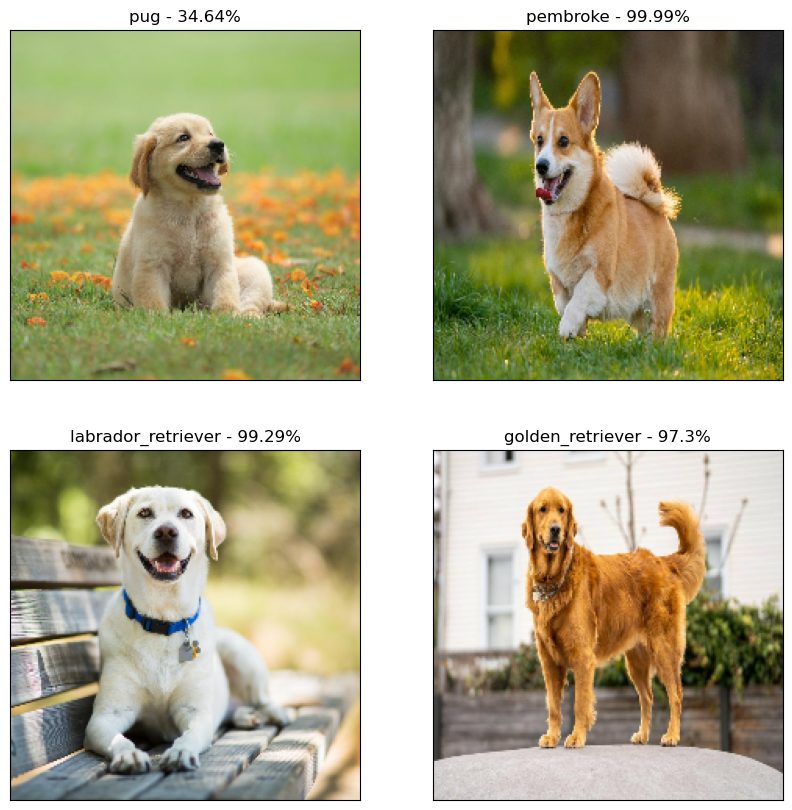

In [129]:
# Plot it
plt.figure(figsize=(10, 10))
for i, image in enumerate(custom_images):
    plt.subplot(2, 2, (i+1))
    plt.xticks([])
    plt.yticks([])
    plt.title(custom_pred_labels[i])
    plt.imshow(image)